Preliminaries for .toml files

In [ ]:
cd("../TestDrive")

In [1]:
] activate .

Main file 

In [2]:
include("src/TestDrive.jl")

population_model (generic function with 1 method)

In [3]:
using Plots
gr()
;

Testing RIDL construct as alternative to MCR 

In [12]:
# New nodes use genetics_ridl; all other elements remain the same as MCR
migrate1 = rand((6*(4+8+6+1+6)), 2, 2) 
migrate2 = rand((6*(4+8+6+1+6)), 2, 2)

firstnode = :FirstNode
secondnode = :SecondNode

example_nodes = [Node(:FirstNode, genetics_ridl, stages_aedes, temp_none, (37.87, 122.27), migrate1),
    Node(:SecondNode, genetics_ridl, stages_aedes, temp_none, (35.87, 120.27), migrate2)]

example_network = Network(example_nodes, 150)
;


In [13]:
# Initialize with wildtype (index 3 in this construct)
u0 = init_node!(example_nodes[1], 3)
;

In [14]:
# Skip right to ODE with CONTROLS
tspan = (0.0,300.0) 
controls = [0.0]

# Construct ODE control problem 
control_model = diffeq.ODEProblem(population_model_node, u0, tspan, (example_nodes[1], controls))

ODEProblem with uType Array{Float64,2} and tType Float64. In-place: true
timespan: (0.0, 300.0)
u0: [2.03711e-18 1.37464e-11 7625.2; 1.94055e-18 1.30918e-11 7262.1; … ; 0.0 3.89635e-20 9.02108e-13; 2.79521e-19 9.02109e-13 500.404]

In [15]:
#alg = Vern8()
#alg = OrdinaryDiffEq.Tsit5() 
alg = Sundials.CVODE_Adams()
#alg = CVODE_BDF()

sol_control = diffeq.solve(control_model, alg, callback = cbs, tstops = tstop)
;

In [16]:
sol_control.u[end]
;

In [17]:
plot(sol_control, title = "RIDL Population with Releases")

In [18]:
males_WW = [val[19,1] for val in sol_control.u] # Homozygous drive
males_WR = [val[19,2] for val in sol_control.u] # Heterozygous drive
males_RR = [val[19,3] for val in sol_control.u] # Homozgous wildtype 
;

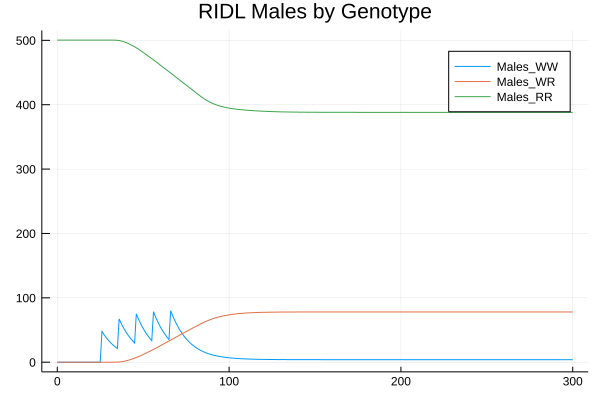

In [19]:
plot(sol_control.t, males_WW, label = "Males_WW", title = "RIDL Males by Genotype")
plot!(sol_control.t, males_WR, label = "Males_WR")
plot!(sol_control.t, males_RR, label = "Males_RR")